In [ ]:
!pip install -r  -q requirements.txt

In [ ]:
!pip install -q "ultralytics<=8.3.40"

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.5/898.5 kB 28.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 79.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 70.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 60.2 MB/s eta 0:00:00


In [ ]:
!pip install -q "supervision>=0.20.0"

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.5/181.5 kB 7.3 MB/s eta 0:00:00


In [ ]:
!gdown -O "/content/data/traffic_analysis.pt" "https://drive.google.com/uc?id=1y-IfToCjRXa3ZdC1JpnKRopC7mcQW-5z"

Downloading...
From (original): https://drive.google.com/uc?id=1y-IfToCjRXa3ZdC1JpnKRopC7mcQW-5z
From (redirected): https://drive.google.com/uc?id=1y-IfToCjRXa3ZdC1JpnKRopC7mcQW-5z&confirm=t&uuid=db990ef4-96f8-4429-9062-9bca11a13ad9
To: /content/data/traffic_analysis.pt
100% 137M/137M [00:01<00:00, 84.6MB/s]


In [ ]:
!gdown --fuzzy "/content/data/0212.mp4 " "https://drive.google.com/file/d/1jq55z815k5U2GfTZlxgme4kO00aPBAGt/view?usp=sharing"

Downloading...
From (original): https://drive.google.com/uc?id=1jq55z815k5U2GfTZlxgme4kO00aPBAGt
From (redirected): https://drive.google.com/uc?id=1jq55z815k5U2GfTZlxgme4kO00aPBAGt&confirm=t&uuid=20202b2f-db93-4d88-ae34-7c76cf44f1ea
To: /content/0212.mp4
100% 489M/489M [00:08<00:00, 54.8MB/s]


In [ ]:
!python ultralytics_example.py     --source_weights_path /content/data/traffic_analysis.pt   --source_video_path /content/data/0212.mp4     --confidence_threshold 0.3     --iou_threshold 0.5     --target_video_path /content/data/traffic_analysis_result.mp4

100% 9025/9025 [10:41<00:00, 14.06it/s]


In [ ]:
import cv2
import os

# Path to the video
video_path = "/content/data/traffic_analysis_result.mp4"

# Create a directory to save frames
output_folder = "/content/frames"
os.makedirs(output_folder, exist_ok=True)

# Open the video file
cap = cv2.VideoCapture(video_path)

frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break  # Exit the loop if video ends

    frame_filename = os.path.join(output_folder, f"frame_{frame_count:04d}.jpg")
    cv2.imwrite(frame_filename, frame)  # Save frame
    frame_count += 1

cap.release()
print(f"Extracted {frame_count} frames and saved in {output_folder}")


Extracted 9025 frames and saved in /content/frames


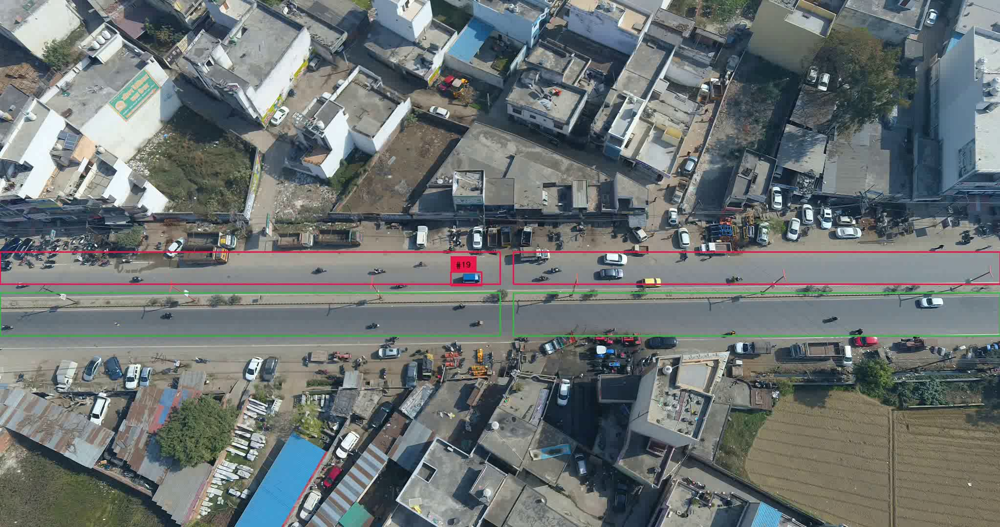

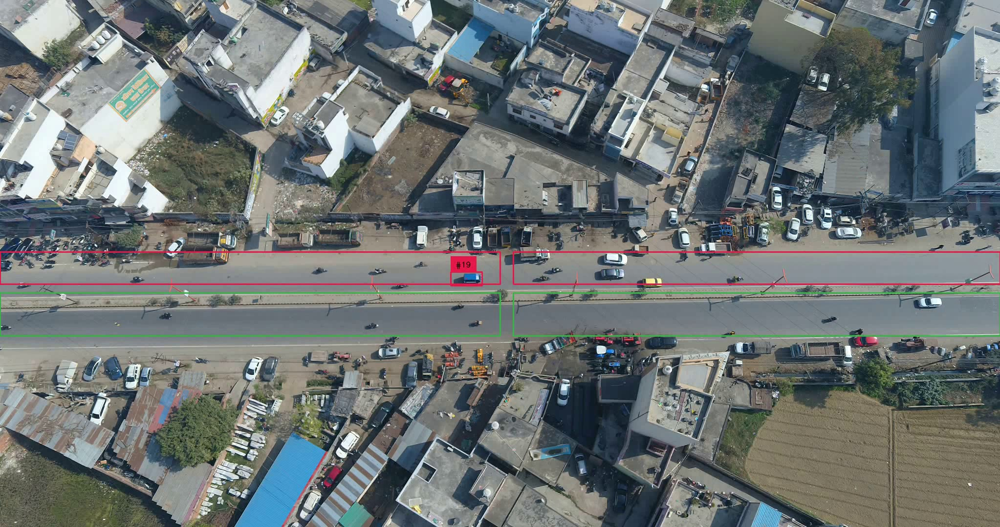

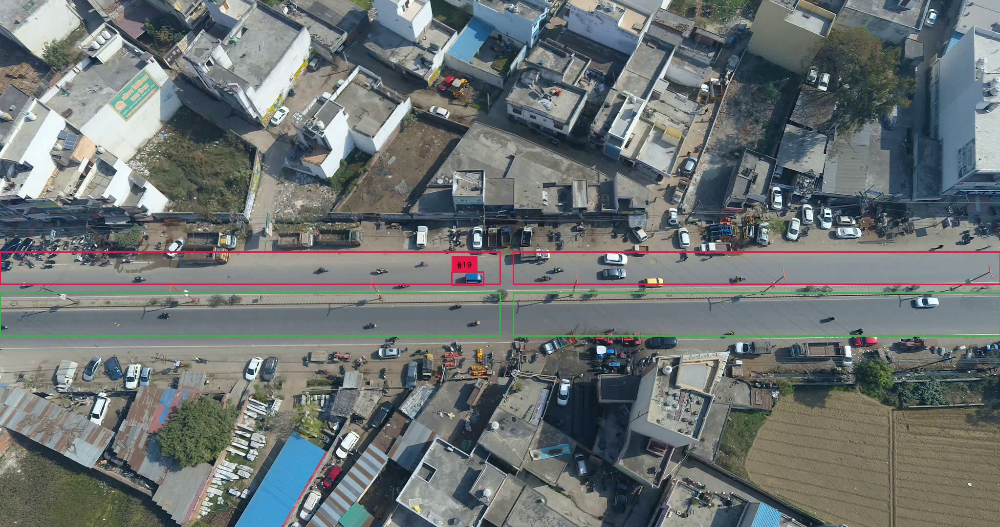

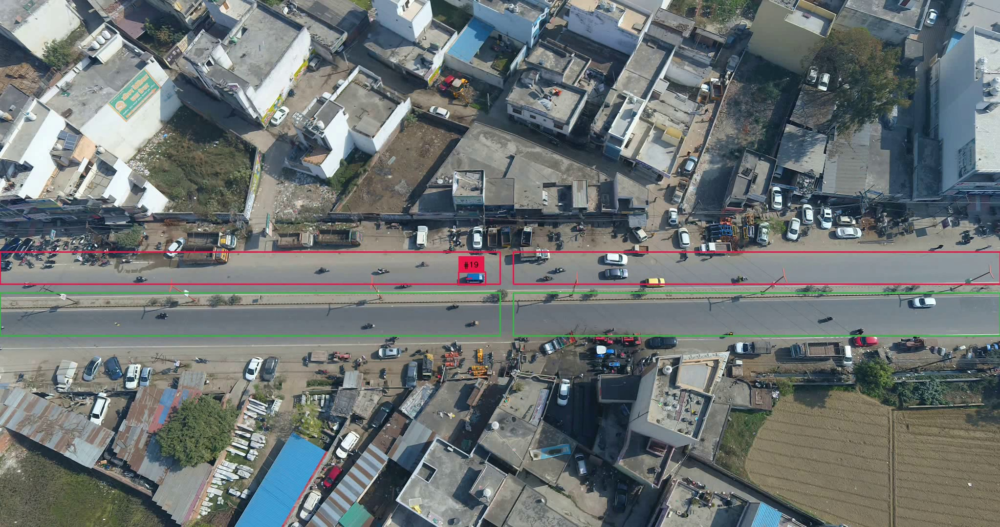

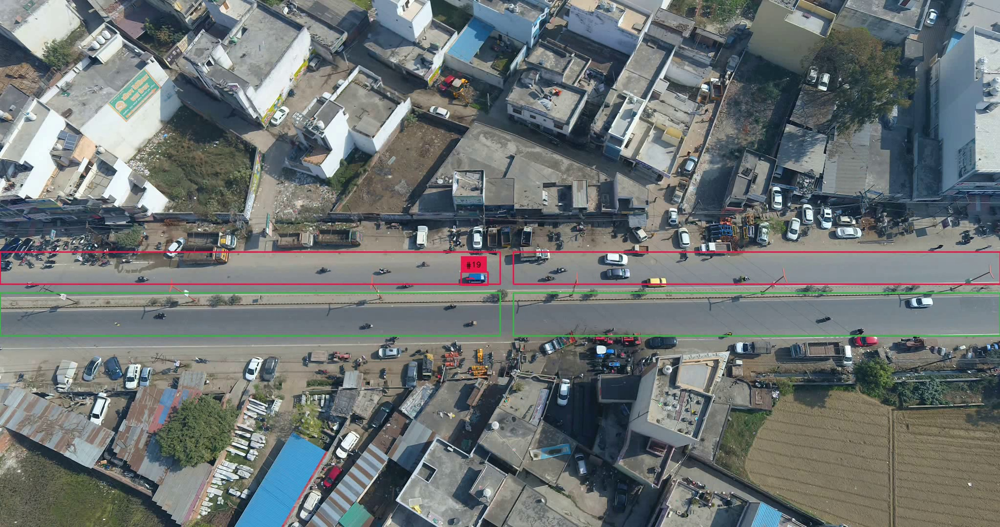

In [ ]:
import IPython.display as display
from PIL import Image

# Show a few extracted frames
frame_files = sorted(os.listdir(output_folder))[:5]  # Show first 5 frames
for frame_file in frame_files:
    img = Image.open(os.path.join(output_folder, frame_file))
    display.display(img)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!mkdir -p "/content/drive/My Drive/cen300"
!cp "/content/data/traffic_analysis_result.mp4" "/content/drive/My Drive/cen300/"